<a href="https://colab.research.google.com/github/ylpulgar/LP_cursos/blob/main/Proyecto_Redes_neuronales_AirB%26B.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Objetivos
- Recopilación de la infromacion usando DataFrames.
- Resumir los datos e identificar los principales descriptivos.
- Visualizar la informacion.
- Tratar ouliers
- Crear un pipeline de transformacion
- Entrenar una regreseion
- Entrenar una red neuronal


### Importar las librerias

In [ ]:
#Librerias comunes
import seaborn as sns
import seaborn as sns
sns.set_style('dark')
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

In [ ]:
# Librerias para visualización 

In [ ]:

import plotly.express as ex
from plotly.subplots import make_subplots
import plotly.graph_objs as go
import plotly.offline as pyo
pyo.init_notebook_mode()
import string
import re
import nltk
from sklearn.decomposition import TruncatedSVD
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import Pipeline

### Recolecion de los datos

Para recopilar la informacion vamos a usar las bases de datos de airbnb publicas en Kaggle,

Kaggle es una subsidiaria de google de aprendizaje colaborativo para la ciencia de datos es de gran ayuda para los estudiantes adquirir conocimientos estudiar las bases allí publicadas

Pagina Principal: https://www.kaggle.com/
Pagina del DataSet: https://www.kaggle.com/kritikseth/us-airbnb-open-data/tasks?taskId=2542 

* Primero vas a descargar las bases de datos para este módulo en el material de clase, la cual se llama AB_US_2020 .
* Luego la vas a guardar en una ubicacion de tu preferencia.
* Luego vas a cambiar la direccion en la lectura del dataframe df_airbnb

Puedes importarla directamente desde la pagina si así lo quisieras, pero en este curso la vamos a importar desde un ubicacion en cada uno de nuestros computadores.


In [ ]:
# Creamos el dataframe df_airbnb usando pandas
df_airbnb = pd.read_csv('/Users/lorenapulgarin/Documents/AB_US_2020.csv')

/Users/ylpulgar/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning:

Columns (4) have mixed types.Specify dtype option on import or set low_memory=False.



In [ ]:
# Para indagar sobre la estructura de los datos usamos df.info()
df_airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 226030 entries, 0 to 226029
Data columns (total 17 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   id                              226030 non-null  int64  
 1   name                            226002 non-null  object 
 2   host_id                         226030 non-null  int64  
 3   host_name                       225997 non-null  object 
 4   neighbourhood_group             110185 non-null  object 
 5   neighbourhood                   226030 non-null  object 
 6   latitude                        226030 non-null  float64
 7   longitude                       226030 non-null  float64
 8   room_type                       226030 non-null  object 
 9   price                           226030 non-null  int64  
 10  minimum_nights                  226030 non-null  int64  
 11  number_of_reviews               226030 non-null  int64  
 12  last_review     

In [ ]:
df_airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,city
0,38585,Charming Victorian home - twin beds + breakfast,165529,Evelyne,NaN,28804,35.65146,-82.62792,Private room,60,1,138,16/02/20,1.14,1,0,Asheville
1,80905,French Chic Loft,427027,Celeste,NaN,28801,35.59779,-82.55540,Entire home/apt,470,1,114,07/09/20,1.03,11,288,Asheville
2,108061,Walk to stores/parks/downtown. Fenced yard/Pet...,320564,Lisa,NaN,28801,35.60670,-82.55563,Entire home/apt,75,30,89,30/11/19,0.81,2,298,Asheville
3,155305,Cottage! BonPaul + Sharky's Hostel,746673,BonPaul,NaN,28806,35.57864,-82.59578,Entire home/apt,90,1,267,22/09/20,2.39,5,0,Asheville
4,160594,Historic Grove Park,769252,Elizabeth,NaN,28801,35.61442,-82.54127,Private room,125,30,58,19/10/15,0.52,1,0,Asheville


Con esta tabla puedes hacerte una idea de cuantas variables tienes, cuantos registros y que tipo de datos tiene cada varioable

In [ ]:

#El primer acercamiento a conocer la base de datos lo hacemos con df.describe()

df_airbnb.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,2.260300e+05,2.260300e+05,226030.000000,226030.000000,226030.000000,2.260300e+05,226030.000000,177428.00000,226030.000000,226030.000000
mean,2.547176e+07,9.352385e+07,35.662829,-103.220662,219.716529,4.525490e+02,34.506530,1.43145,16.698562,159.314856
std,1.317814e+07,9.827422e+07,6.849855,26.222091,570.353609,2.103376e+05,63.602914,1.68321,51.068966,140.179628
min,1.090000e+02,2.300000e+01,18.920990,-159.714900,0.000000,1.000000e+00,0.000000,0.01000,1.000000,0.000000
25%,1.515890e+07,1.399275e+07,32.761783,-118.598115,75.000000,1.000000e+00,1.000000,0.23000,1.000000,0.000000
50%,2.590916e+07,5.138266e+07,37.261125,-97.817200,121.000000,2.000000e+00,8.000000,0.81000,2.000000,140.000000
75%,3.772624e+07,1.497179e+08,40.724038,-76.919322,201.000000,7.000000e+00,39.000000,2.06000,6.000000,311.000000
max,4.556085e+07,3.679176e+08,47.734620,-70.995950,24999.000000,1.000000e+08,966.000000,44.06000,593.000000,365.000000


El cual nos proporciona, la media, la desviación estándar y la mediana:
Puedes notar que parala variable precio del airbnb:
* la media es de 219 dolares  
* Y su mediana es de 121 dolares lo cual es un indicador de mucha variabilidad en los datos 
* lo podemos contrastar con el valor de la desviacion estandar que es de 570 dolares

In [ ]:
#TuretoAquí 
#encuentra mas data point en las variables numericas de interes como number_of_reviews, reviews_per_months, calculated_host_listings_counts, availability_365

### Vamos a separar  por variables categóricas y por numéricas y a las variables categóricas las vamos a analizar usando tablas con .groupby()

In [ ]:
categorical_data =df_airbnb.select_dtypes(exclude=[np.number])
categorical_data.shape[1]

7

In [ ]:
categorical_data.head()

,name,host_name,neighbourhood_group,neighbourhood,room_type,last_review,city
0,Charming Victorian home - twin beds + breakfast,Evelyne,NaN,28804,Private room,16/02/20,Asheville
1,French Chic Loft,Celeste,NaN,28801,Entire home/apt,07/09/20,Asheville
2,Walk to stores/parks/downtown. Fenced yard/Pet...,Lisa,NaN,28801,Entire home/apt,30/11/19,Asheville
3,Cottage! BonPaul + Sharky's Hostel,BonPaul,NaN,28806,Entire home/apt,22/09/20,Asheville
4,Historic Grove Park,Elizabeth,NaN,28801,Private room,19/10/15,Asheville


### vamos a crear tablas solo para room_type y city, y las variables como name y host_name las tranformaremos en nuestro capitulo de feacture engineering

In [ ]:
categorical_data['room_type'].value_counts(normalize=True)

Entire home/apt    0.682091
Private room       0.291497
Shared room        0.017825
Hotel room         0.008587
Name: room_type, dtype: float64

In [ ]:
#TuRetoAquí

### Como puedes notar el 68% de los resgistros de airbnb son entire home/apt, seguido de Private room, Share room y y por ultimo la etiqueta con menos registros Hotel room

# Visualizacion de los datos

Ahora vamos a visualizar la distribución de los datos, con la cual no solo podemos adquirir insights, 
sino que también vamos a identificar outliers para el posterior tratamiento, primero vamos a construir un histograma y después un boxplot.

En la introduccion a visualizacion vimos algunos fundamentos de lo que puede ser necesario visualizar en ciencia de Datos, partimos de nuestra pregunta en el centro y despues lo que queriamos mostrar en nuestro mapa mental y despues partimos ese mapa mental en cuatro partes, vamos a aplicar ese mapa mental a cada una de las cosas que queremos visualizar

## Distribucciones 

Precio

Text(0.5, 0, 'Precio (Dolares)')

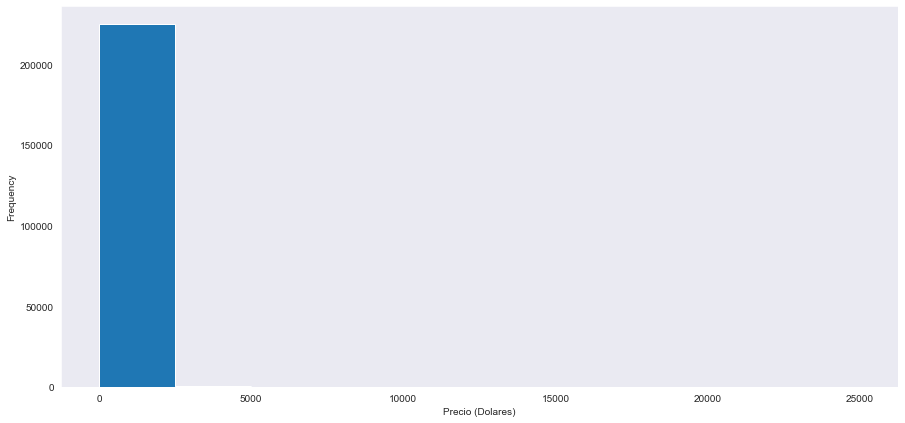

In [ ]:
ax = df_airbnb['price'].plot.hist(figsize=(15,7)) 
ax.set_xlabel('Precio (Dolares)' ) 


<AxesSubplot:xlabel='price'>

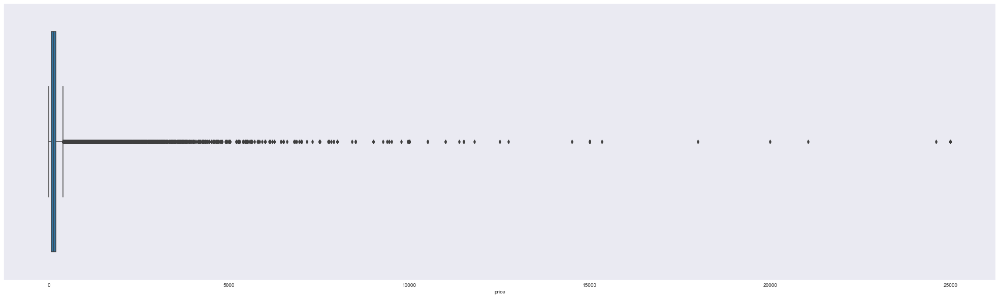

In [ ]:
fig_dims = (35, 10)
fig, ax = plt.subplots(figsize=fig_dims)
sns.boxplot(x='price', data=df_airbnb)

Como puedes ver existe una amplia dispercion en el precio,
esto puede darse por las caracteristicas de cada airbnb como la ciudad y el tipo de habitacion, y la ubicacion
Vamos a analizar el precio por otras caracteristicas para tener algo mas visual
Lo cual Implica indagar por relaciones

## Relaciones

<AxesSubplot:>

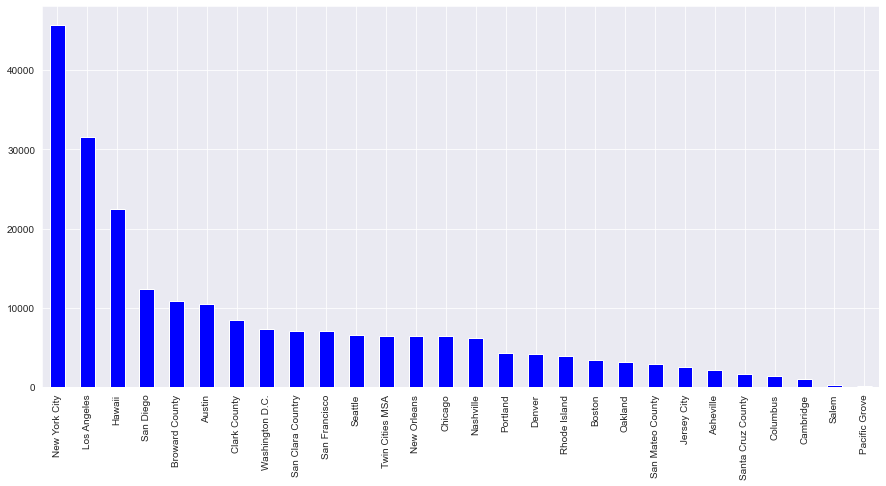

In [ ]:
(df_airbnb['city'].value_counts()).plot(kind='bar',color = 'blue', figsize=(15,7))


<AxesSubplot:xlabel='city'>

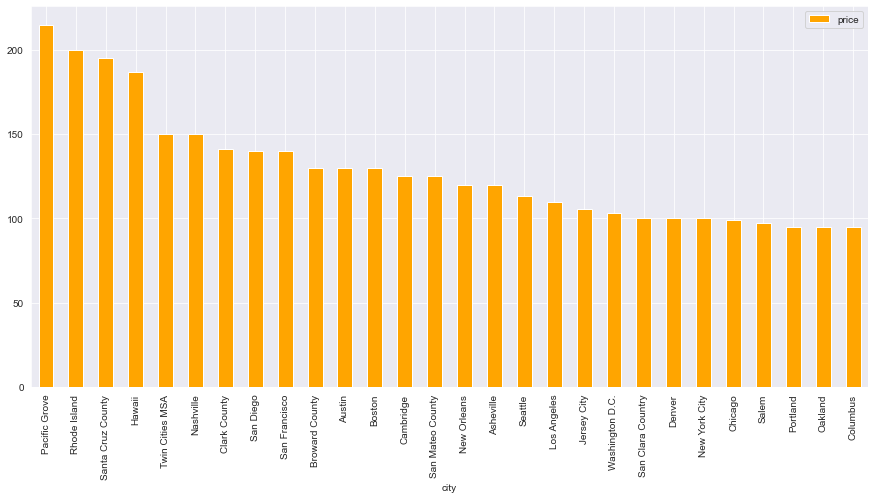

In [ ]:

#Primero creo un data frame con el precio medio usando mediana ya que vimos que el precio tiene mucha dispersion
df_plot_city_precio= pd.DataFrame(pd.pivot_table(data=df_airbnb,index=['city'],aggfunc={'price': np.median ,'price': np.median})).sort_values(by=['price'], ascending=False)

#Ahora grafico la anterior tabla de sumarizacion

df_plot_city_precio.plot(kind='bar',color = 'orange', figsize=(15,7))



Como puedes ve la ciudad es una caracteristica que hace que el precio crezca vamos a ver nuestras graficas de distribuccion por ciudad

In [ ]:
#TuretoAquí es correr las mismas graficas anteriores para precio para room_type
# room_type vs Price


## BoxPlot por ciudades

<AxesSubplot:xlabel='city', ylabel='price'>

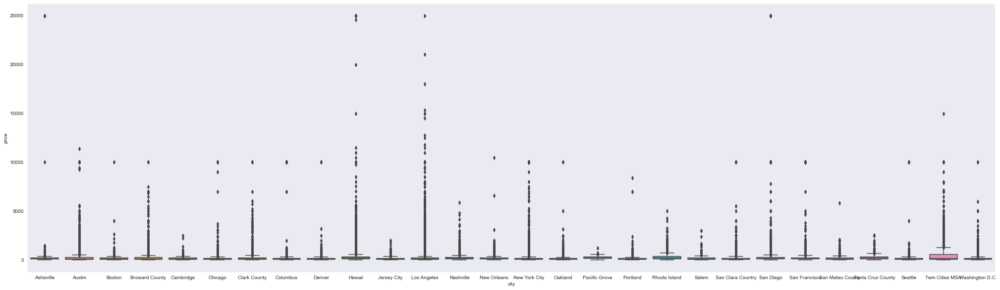

In [ ]:
fig_dims = (35, 10)
fig, ax = plt.subplots(figsize=fig_dims)
sns.boxplot(x='city', y='price', data=df_airbnb)

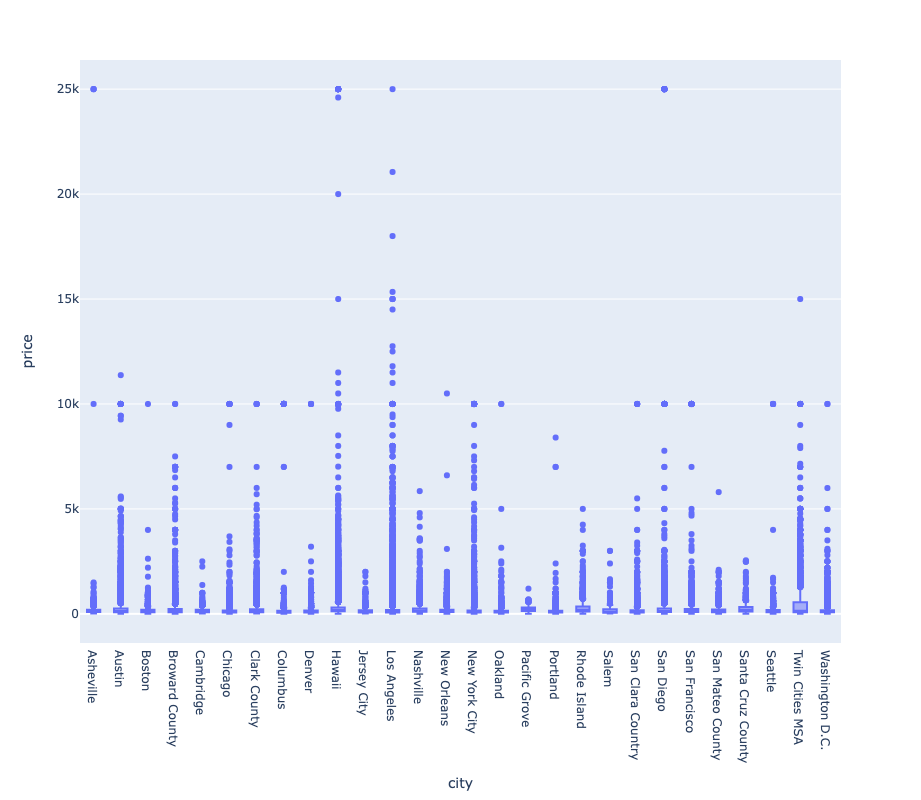

In [ ]:
import plotly.express as px

fig = px.box(df_airbnb,x='city', y='price',width=1000, height=800)
fig.show()

In [ ]:
Sigue existiendo mucha dispersion por ciudad podriamos irnos un poco mas profundo a indagar por relacion con mas detalle como la longitud y latitud

In [ ]:
#TuretoAquí es correr las mismas graficas para room_type
# BoxPlot room_type vs Price


# Relaciones

## Matriz de correlaciones

En el heatmap podemos identificar las variables con mayor correlacion con nuestra variable objetivo precio:
* 'calculated_host_listings_count'
* 'availability_365'
* 'minimum_nights'
* 'room_type','city' 


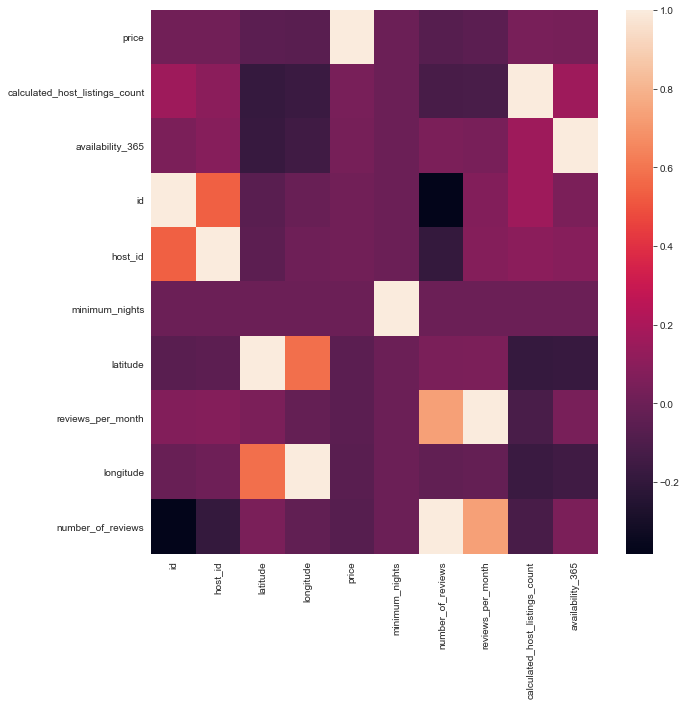

In [ ]:
PriceCorr = sns.heatmap(df_airbnb.corr(method='pearson').sort_values(by=['price'], ascending=False))

Identica las mejores variables 

### Grafico de dispersion

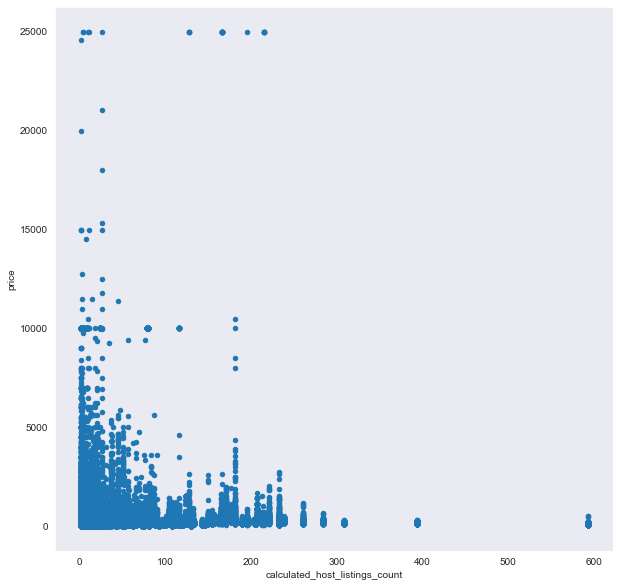

In [ ]:
df_airbnb.plot.scatter('calculated_host_listings_count', 'price');

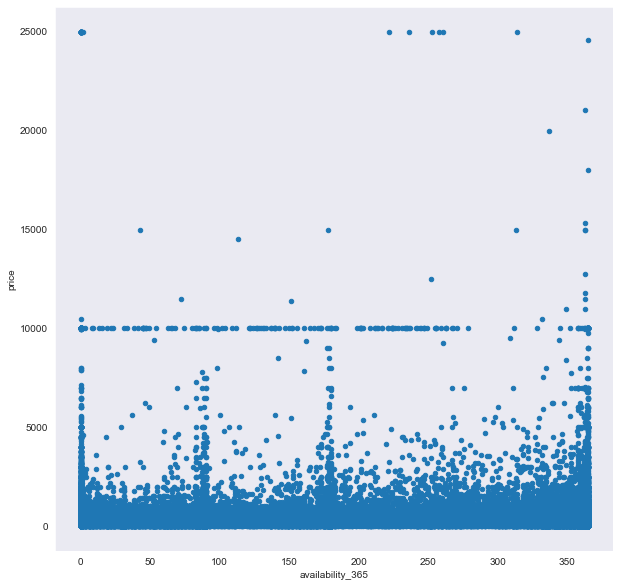

In [ ]:
df_airbnb.plot.scatter('availability_365', 'price');

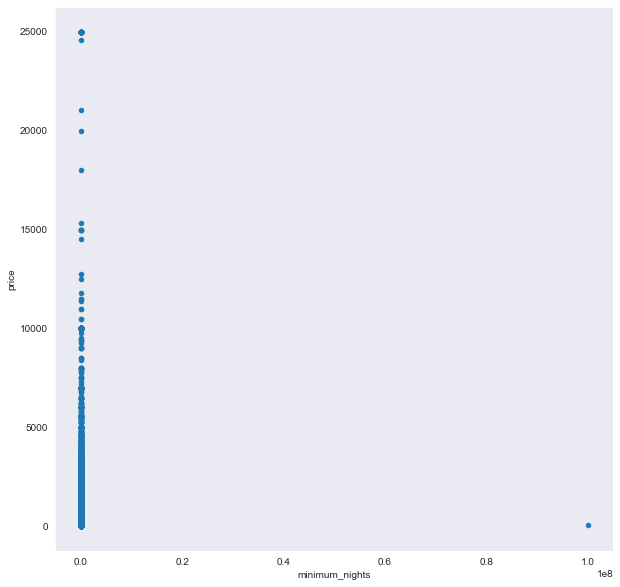

In [ ]:
df_airbnb.plot.scatter('minimum_nights', 'price');

No podemos usar esta variable ya que no tenemos variabilidad 

In [ ]:
#TuRetoAquí Encontrar valores ausentes

# Para resumir el análisis 

* La variable neighbourhood_group	 tiene el 51% de valores ausentes no la tendremos en cuenta
* Y last_review reviews_per_month tiene el 21 vamos a tratar estos missings en el pipeline de transformacion


* 'minimum_nights' no tiene variabilidad

In [ ]:
Y existen muchos valores atipicos que no son bien explicados por las caracteristicas que vamos a tratar en nuestro proximo proyecto

In [ ]:
# Removing Outliers
lower_bound = .10
upper_bound = .90
df_airbnb_clean = df_airbnb[df_airbnb['price'].between(df_airbnb['price'].quantile(lower_bound), df_airbnb['price'].quantile(upper_bound), inclusive=True)]



De nuestro proyecto anterior y el analisis de correlaciones identificamos variables con correlacion muy baja o negativa como
vamos a tener en cuenta solo las correlaciones positivas mayores a o en nuestra lista e categorias

### Selección de caracteristicas X y variable objetivo Y

In [ ]:
#TuretoAquí definir el vector de caracteriscas y Y
X = df_airbnb_clean[[]]
y = df_airbnb_clean[]

### Seleccion de la muestra de entrenamiento y test

In [ ]:

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=101)

### Definir las variables tipo categoricas

In [ ]:
#TuretoAquí

In [ ]:
print(categorical )

['room_type', 'city']


### Definir las variables tipo numericas

In [ ]:
#TuretoAquí

### Definir un pipeline de transformacion Categorico

In [ ]:
# Define categorical pipeline
Define un pipeline de transformacion guiandote del modelo de default del anterior proyecto

In [ ]:
from sklearn.neural_network import NN


In [ ]:
#turetoAquí

In [ ]:
reg = NN(hidden_layer_sizes=(X),activation= X ,random_state=1, max_iter=X).fit(X_test_transform, y_test)

/Users/lorenapulgarin/opt/anaconda3/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:587: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


In [ ]:
reg.score(X_test_transform, y_test)

0.3557089899519651